# Probe Trajectory Planning

## Required library
- opencv: run "pip install opencv-python"
- Pillow: run "pip install --upgrade Pillow"
- Matplotlib: run "conda install matplotlib"

## Specify the number and AP for the insertion and the target region

In [1]:
# Specify the file ID on atlas
id_insert = 44
id_target = 87

# Specify the insertion and target coordinates in mm
x_insert_mm = 4
y_insert_mm = 1.6

x_target_mm = 5.7
y_target_mm = 7.4

x_target_mm = 5.7
y_target_mm = 7.4

In [5]:
# Specify the file ID on atlas
id_insert = 52
id_target = 57

# Specify the insertion and target coordinates in mm
x_insert_mm = 3.9
y_insert_mm = 1.6

x_target_mm = 4.5
y_target_mm = 4.8

## Run this

In [6]:
TrajectoryPlanning(id_insert, id_target, x_insert_mm, y_insert_mm, x_target_mm, y_target_mm)

Insertion: Plate 50 , sinus 5.71 (mm)
Target: Plate 55 , sinus 4.89 (mm)
AP_angle: 17.62 degree
ML_angle: 36.19 degree
Trajectory Length: 3.357439500571827 mm


In [24]:
# Specify the insertion and target coordinates in mm
trajectory_name = 'MEC_3'

id1    = 74
ML1_mm = 5
DV1_mm = 2

id2    = 81
ML2_mm = 5.8
DV2_mm = 9.8

TrajectoryPlanning_v2(trajectory_name, id1, id2, ML1_mm, ML2_mm, DV1_mm, DV2_mm)

Target region 1: Plate 74 , sinus 2.26 (mm)
Target region 2: Plate 81 , sinus 1.28 (mm)
Azimuth: 39.23 degree
Pitch: 9.21 degree


In [46]:
# Specify the insertion and target coordinates in mm
trajectory_name = 'dCA1_vCA1_2'

for id in range(58,65):
    id1    = id
    ML1_mm = 5
    DV1_mm = 4
    
    id2    = id
    ML2_mm = 4.2
    DV2_mm = 10

    TrajectoryPlanning_v2(trajectory_name, id1, id2, ML1_mm, ML2_mm, DV1_mm, DV2_mm)

Target region 1: Plate 58 , sinus 4.72 (mm)
Target region 2: Plate 58 , sinus 4.72 (mm)
Azimuth: 270.0 degree
Pitch: 7.59 degree
Target region 1: Plate 59 , sinus 4.56 (mm)
Target region 2: Plate 59 , sinus 4.56 (mm)
Azimuth: 270.0 degree
Pitch: 7.59 degree
Target region 1: Plate 60 , sinus 4.48 (mm)
Target region 2: Plate 60 , sinus 4.48 (mm)
Azimuth: 270.0 degree
Pitch: 7.59 degree
Target region 1: Plate 61 , sinus 4.31 (mm)
Target region 2: Plate 61 , sinus 4.31 (mm)
Azimuth: 270.0 degree
Pitch: 7.59 degree
Target region 1: Plate 62 , sinus 4.23 (mm)
Target region 2: Plate 62 , sinus 4.23 (mm)
Azimuth: 270.0 degree
Pitch: 7.59 degree
Target region 1: Plate 63 , sinus 4.15 (mm)
Target region 2: Plate 63 , sinus 4.15 (mm)
Azimuth: 270.0 degree
Pitch: 7.59 degree
Target region 1: Plate 64 , sinus 3.9 (mm)
Target region 2: Plate 64 , sinus 3.9 (mm)
Azimuth: 270.0 degree
Pitch: 7.59 degree


In [44]:
# Specify the insertion and target coordinates in mm
trajectory_name = 'dCA1_vCA1_3'

id1    = 59
ML1_mm = 4.8
DV1_mm = 3.8

id2    = 63
ML2_mm = 5.6
DV2_mm = 9.6

TrajectoryPlanning_v2(trajectory_name, id1, id2, ML1_mm, ML2_mm, DV1_mm, DV2_mm)

Target region 1: Plate 59 , sinus 4.56 (mm)
Target region 2: Plate 63 , sinus 4.15 (mm)
Azimuth: 62.86 degree
Pitch: 8.81 degree


In [43]:
# Specify the insertion and target coordinates in mm
trajectory_name = 'dCA1_vCA1_4'

diff = 2

id1    = 55+diff
ML1_mm = 3.9
DV1_mm = 3.4

id2    = 61+diff
ML2_mm = 3.9
DV2_mm = 10.1

TrajectoryPlanning_v2(trajectory_name, id1, id2, ML1_mm, ML2_mm, DV1_mm, DV2_mm)

Target region 1: Plate 57 , sinus 4.89 (mm)
Target region 2: Plate 63 , sinus 4.15 (mm)
Azimuth: 0.0 degree
Pitch: 6.3 degree


In [22]:
# Specify the insertion and target coordinates in mm
trajectory_name = 'dCA1-MEC_3'

id1    = 67
ML1_mm = 5.8
DV1_mm = 5

id2    = 77
ML2_mm = 6.6
DV2_mm = 10.0

TrajectoryPlanning_v2(trajectory_name, id1, id2, ML1_mm, ML2_mm, DV1_mm, DV2_mm)

Target region 1: Plate 67 , sinus 3.41 (mm)
Target region 2: Plate 77 , sinus 1.77 (mm)
Azimuth: 26.0 degree
Pitch: 20.05 degree


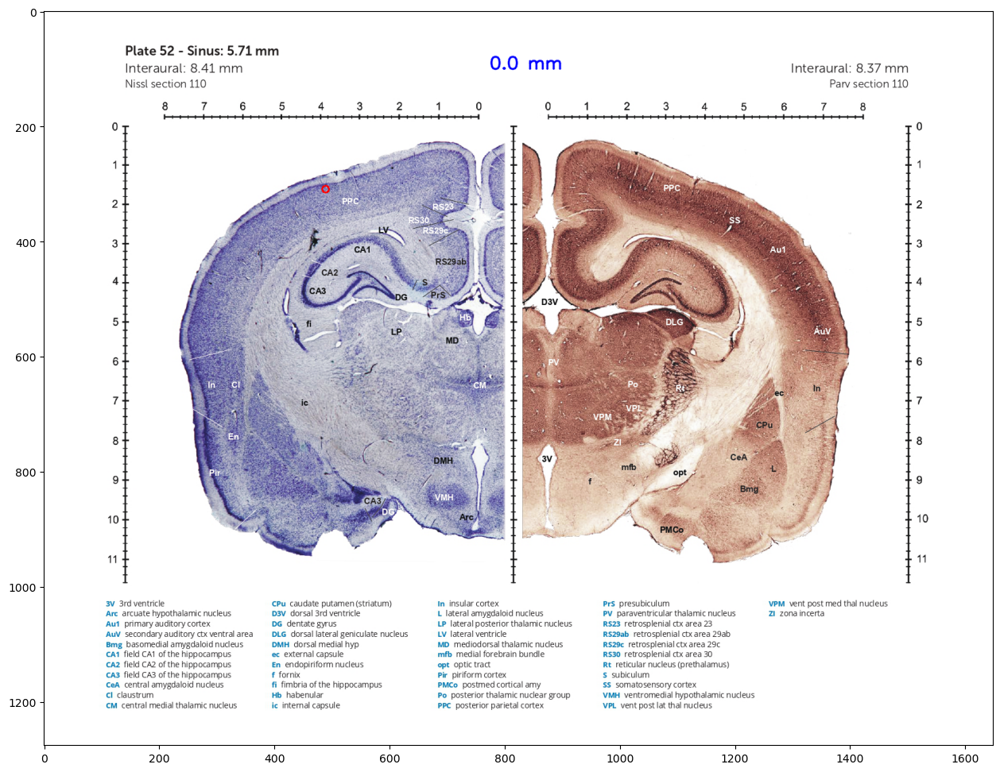

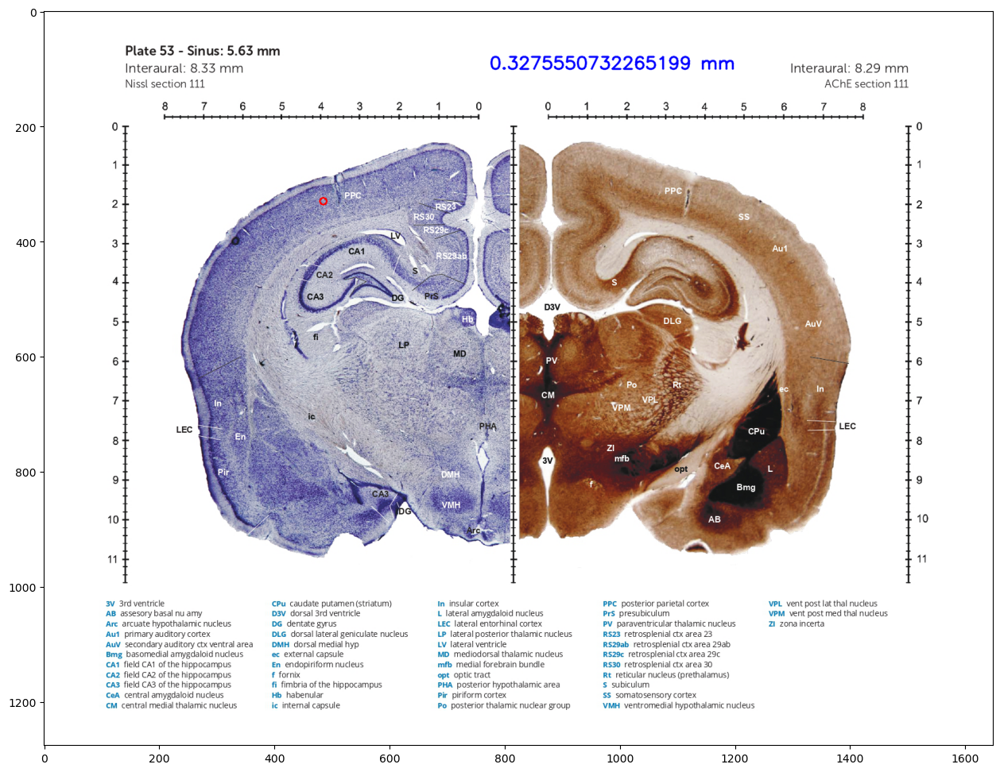

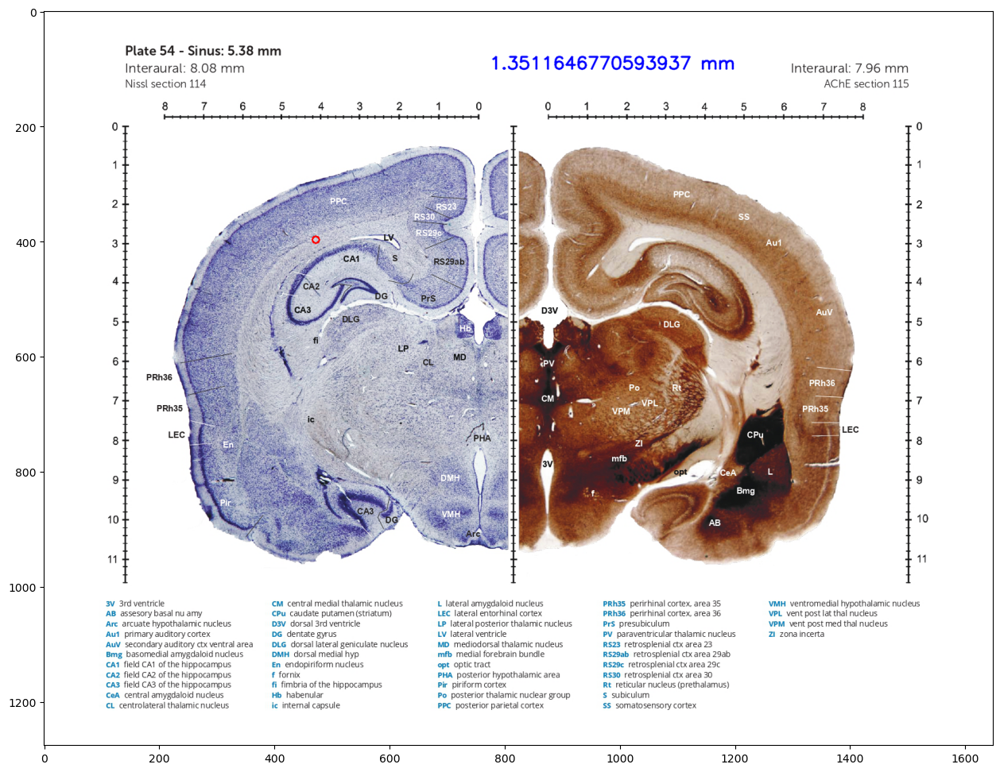

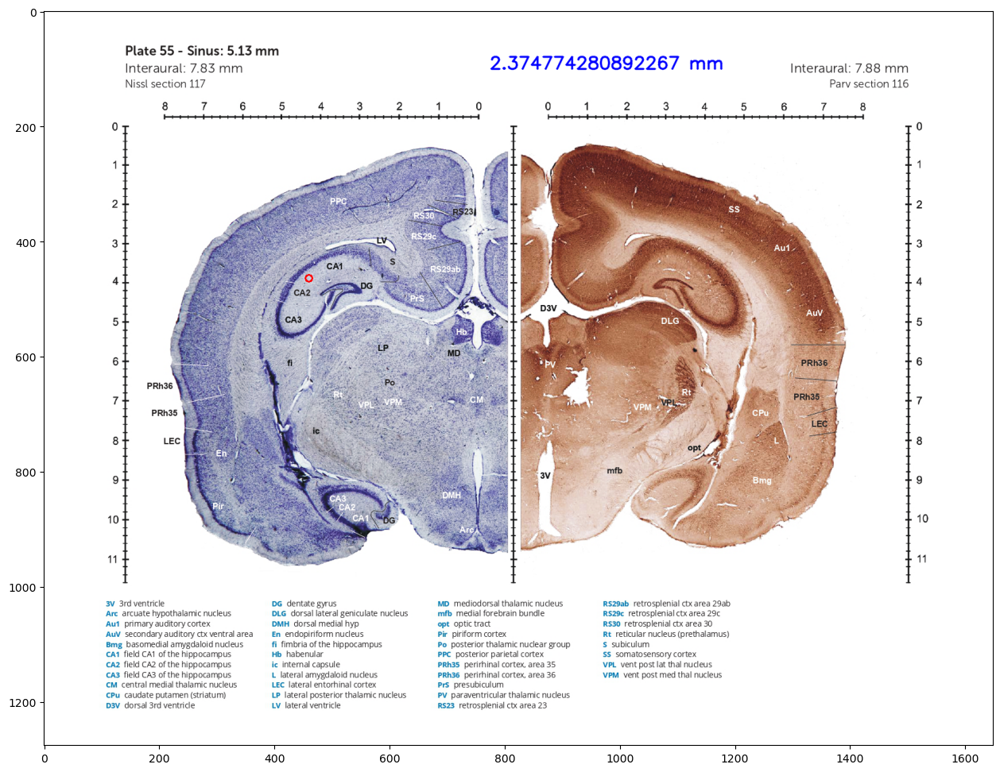

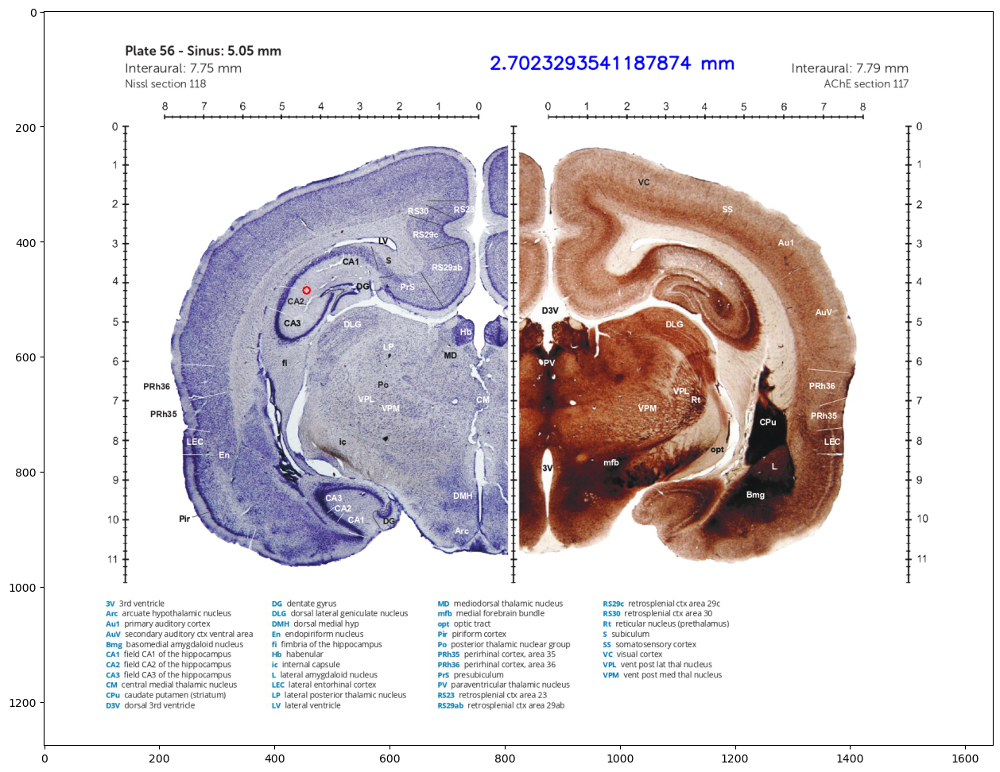

...

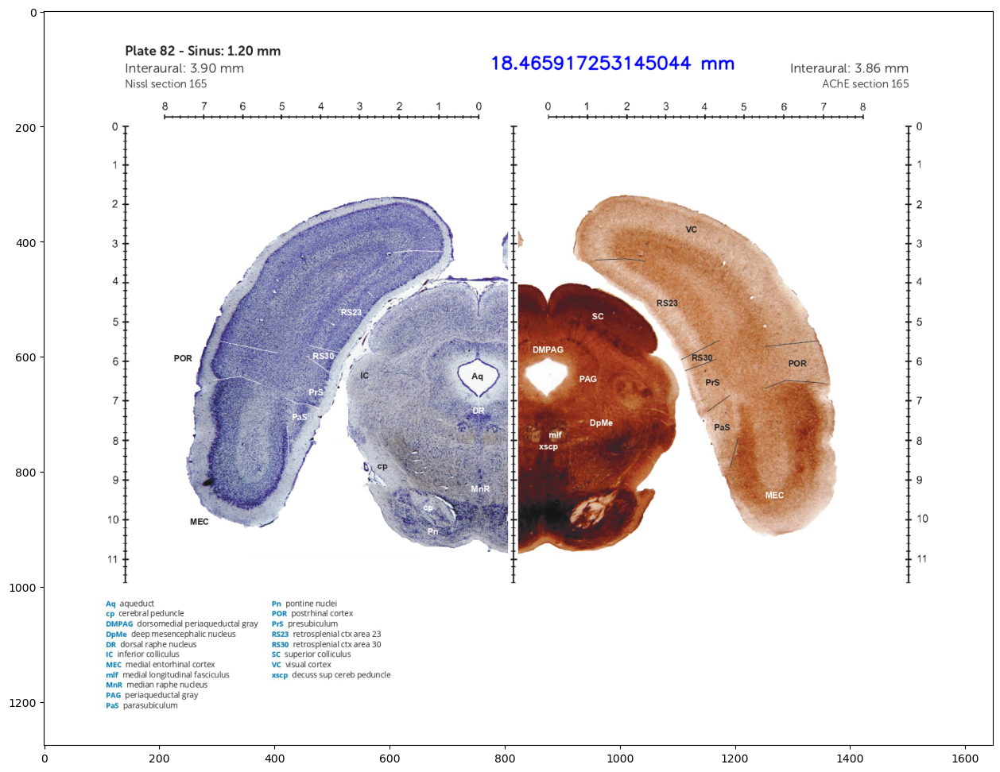

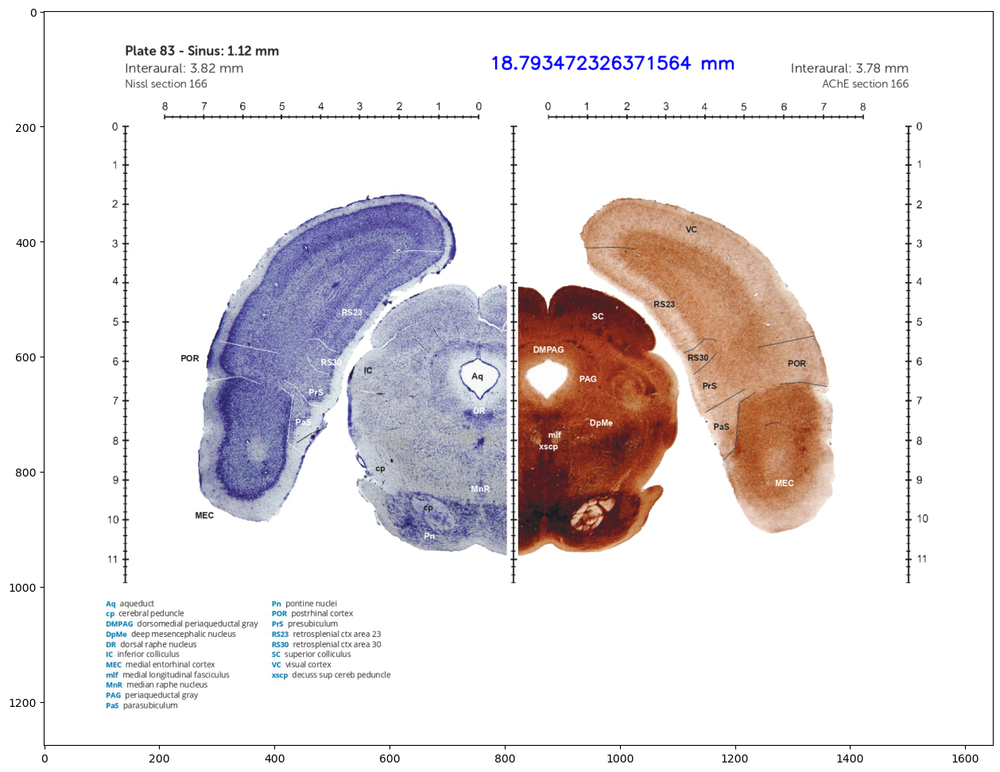

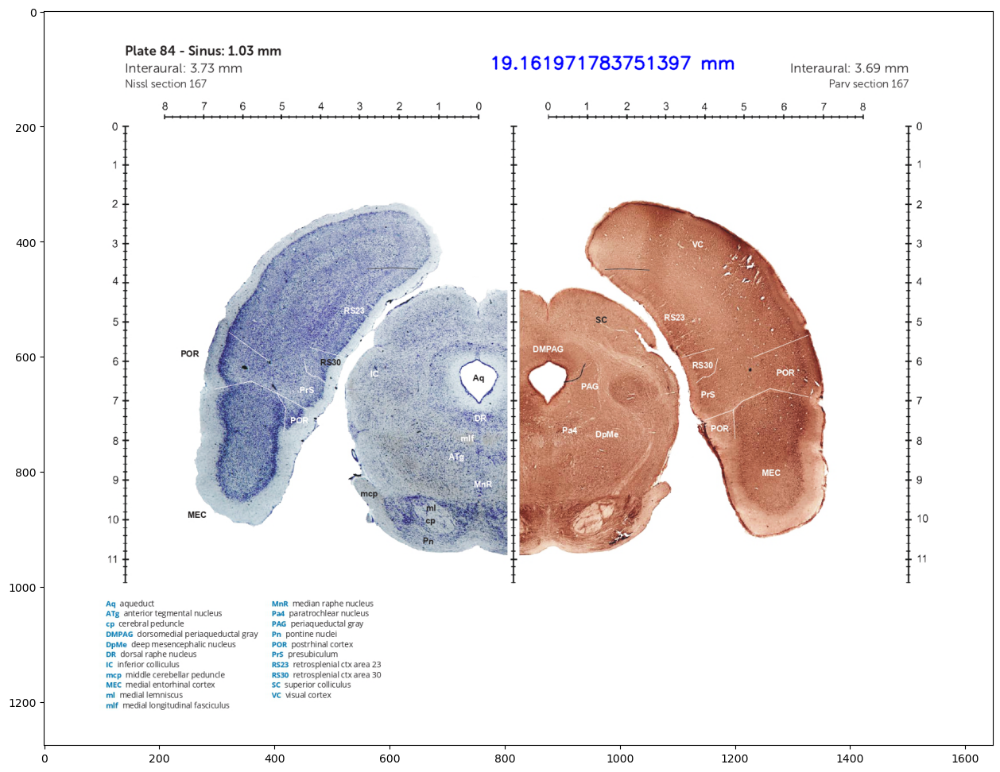

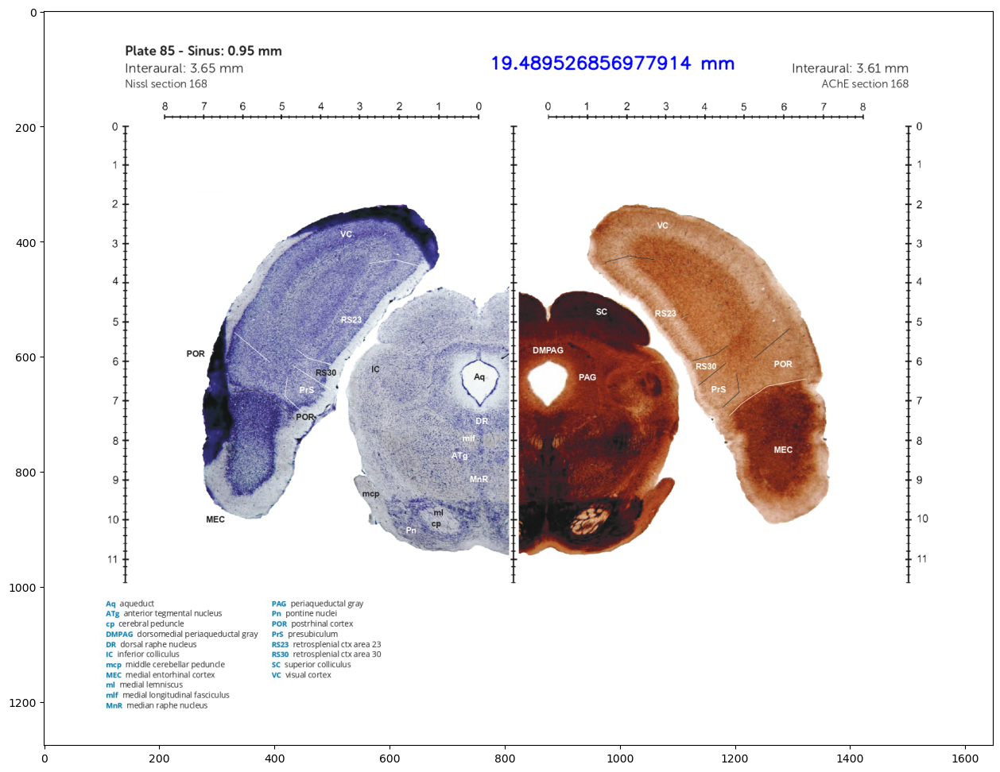

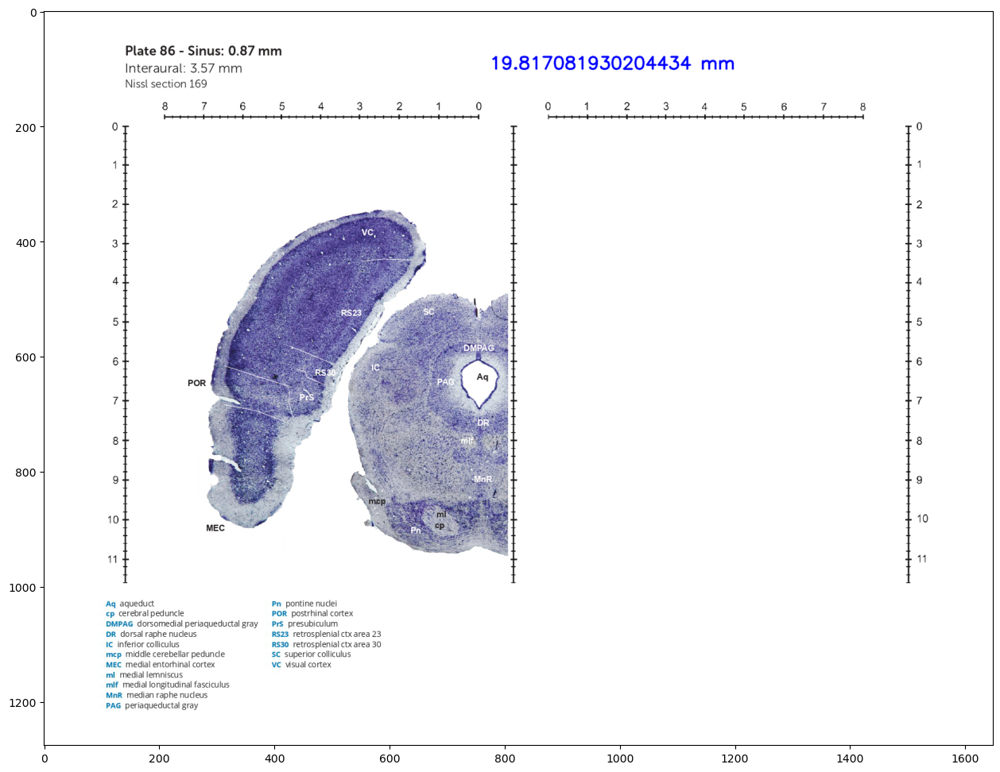

IndexError: list index out of range

In [7]:
ReconstructTrajectory(id_insert, id_target, x_insert_mm, y_insert_mm, x_target_mm, y_target_mm)

## Function

In [14]:
# Import libraries
from PIL import Image, ImageDraw, ImageFont
import math
import os 
import sys
from datetime import datetime
import glob
import numpy as np
import cv2
import pickle
import matplotlib.pyplot as plt

def TrajectoryPlanning_v2(trajectory_name, id1, id2, ML1_mm, ML2_mm, DV1_mm, DV2_mm):
    # Coordinates in pixels
    ML_lim = [755, 210] # [0,8]
    DV_lim = [200, 993] # [0, 11.6]
    
    # Convert coordinates
    ML1 = ML_lim[0] + ML1_mm * (ML_lim[1] - ML_lim[0])/8
    DV1 = DV_lim[0] + DV1_mm * (DV_lim[1] - DV_lim[0])/11.6
    ML2 = ML_lim[0] + ML2_mm * (ML_lim[1] - ML_lim[0])/8
    DV2 = DV_lim[0] + DV2_mm * (DV_lim[1] - DV_lim[0])/11.6
    
    # AP coordinates for slices
    with open("AP", "rb") as fp:   # Unpickling
        AP_ls = pickle.load(fp)
    
    # AP coordinates of insertion and target
    AP1_mm = AP_ls[id1-1]
    AP2_mm = AP_ls[id2-1]
    
    # load images and mark trajectories
    atlas_path = 'atlas'
    img_ls = [f'{i:04d}.jpg' for i in range(1,len(os.listdir(atlas_path))+1)]
    
    # Make save directory
    # now = datetime.now()
    # dt_string = now.strftime("%Y-%m-%d_%H-%M-%S")
    # os.mkdir(dt_string)
    output_dir = trajectory_name
    if not os.path.isdir(trajectory_name):
        os.mkdir(output_dir)
    #print(AP_insert, AP_target)
    
    # Compute and print the angles
    p3d1 = np.array([AP1_mm, ML1_mm, DV1_mm])
    p3d2 = np.array([AP2_mm, ML2_mm, DV2_mm])
    probe_vector = p3d2 - p3d1
    probe_vector_length = np.linalg.norm(probe_vector)
    
    probe_angle = cartesian2polar(probe_vector) # r, azimuth, pitch
    
    AP0_mm = AP_ls[0] # AP coordinate of the initial slice
    
    if id1 != id2:
        for id in range(len(AP_ls)):
            im_path = os.path.join(atlas_path,img_ls[id])
            im = np.array(Image.open(im_path))
            AP_mm = AP_ls[id]
            AP_dist_mm = np.abs(AP0_mm - AP_mm) # Distance between the initial and the second slice
            probe_depth = probe_vector_length * AP_dist_mm / np.abs(probe_vector[0])

            # Compute ML and DV pixels in the current slice
            ML = ML1 + (ML2 - ML1) * (AP_mm - AP1_mm) / (AP2_mm - AP1_mm)
            DV = DV1 + (DV2 - DV1) * (AP_mm - AP1_mm) / (AP2_mm - AP1_mm)

            if ML < ML_lim[0] and ML > ML_lim[1]:
                if DV > DV_lim[0] and DV < DV_lim[1]:
                    im = cv2.circle(im, np.array([ML,DV]).astype(np.int16), 6, [255,0,0], 2)
            font = cv2.FONT_HERSHEY_SIMPLEX
            im = cv2.putText(im, f'Length from AP0: {round(probe_depth,2)} mm', (np.array(im).shape[1]//2 - 50, 50), font, 1, [0,0,255], 2, cv2.LINE_AA)
            im = cv2.putText(im, f'Azimuth: {round(probe_angle[1],2)}', (np.array(im).shape[1]//2 - 50, 100), font, 1, [0,0,255], 2, cv2.LINE_AA)
            im = cv2.putText(im, f'Pitch: {round(probe_angle[2],2)}', (np.array(im).shape[1]//2 - 50, 150), font, 1, [0,0,255], 2, cv2.LINE_AA)
            # Save images
            cv2.imwrite(os.path.join(output_dir, str(f'{id+1:03d}') + '_AP' + str(AP_mm)) + '.jpg', im)
    else:
        DV = DV_lim[0]
        ML = ML1 + (ML2 - ML1) * (DV - DV1) / (DV2 - DV1)
        
        id = id1-1
        im_path = os.path.join(atlas_path,img_ls[id])
        im = np.array(Image.open(im_path))
        AP_mm = AP1_mm
        probe_depth = probe_vector_length
        font = cv2.FONT_HERSHEY_SIMPLEX
        im = cv2.putText(im, f'Length: {round(probe_depth,2)} mm', (np.array(im).shape[1]//2 - 50, 50), font, 1, [0,0,255], 2, cv2.LINE_AA)
        im = cv2.putText(im, f'Azimuth: {round(probe_angle[1],2)}', (np.array(im).shape[1]//2 - 50, 100), font, 1, [0,0,255], 2, cv2.LINE_AA)
        im = cv2.putText(im, f'Pitch: {round(probe_angle[2],2)}', (np.array(im).shape[1]//2 - 50, 150), font, 1, [0,0,255], 2, cv2.LINE_AA)
        im = cv2.circle(im, np.array([ML1,DV1]).astype(np.int16), 6, [255,0,0], 2)
        im = cv2.circle(im, np.array([ML2,DV2]).astype(np.int16), 6, [255,0,0], 2)
        im = cv2.line(im, np.array([ML,DV]).astype(np.int16), np.array([ML2,DV2]).astype(np.int16),[255,0,0], 2)
        # Save images
        cv2.imwrite(os.path.join(output_dir, str(f'{id+1:03d}') + '_AP' + str(AP_mm)) + '.jpg', im)
    
    # Print
    print("Target region 1: Plate", str(id1), ", sinus", AP1_mm, "(mm)")
    print("Target region 2: Plate", str(id2), ", sinus", AP2_mm, "(mm)")
    
    print("Azimuth:", round(probe_angle[1],2), "degree")
    print("Pitch:", round(probe_angle[2],2), "degree")

def cartesian2polar(position):
    newPosition = np.empty(3, dtype=np.float64)
    newPosition[0] = np.linalg.norm(position, axis=0) # r
    newPosition[1] = np.abs(180 - math.degrees(np.arctan2(position[1], position[0]))) # Azimuth
    newPosition[2] = math.degrees(np.arccos(position[2]/newPosition[0])) # Pitch
    return newPosition

In [1]:
# Import libraries
from PIL import Image, ImageDraw, ImageFont
import math
import os 
import sys
from datetime import datetime
import glob
import numpy as np
import cv2
import pickle
import matplotlib.pyplot as plt


def ReconstructTrajectory(id_insert, id_target, x_insert_mm, y_insert_mm, x_target_mm, y_target_mm):
    # Coordinates in pixels
    x_lim = [755, 210] # [0,8]
    y_lim = [200, 993] # [0, 11.6]

    # Convert coordinates
    x_insert = x_lim[0] + x_insert_mm * (x_lim[1] - x_lim[0])/8
    y_insert = y_lim[0] + y_insert_mm * (y_lim[1] - y_lim[0])/11.6
    x_target = x_lim[0] + x_target_mm * (x_lim[1] - x_lim[0])/8
    y_target = y_lim[0] + y_target_mm * (y_lim[1] - y_lim[0])/11.6

    # AP coordinates for slices
    with open("AP", "rb") as fp:   # Unpickling
        AP_ls = pickle.load(fp)

    # AP coordinates of insertion and target
    AP_insert = AP_ls[id_insert-1]
    AP_target = AP_ls[id_target-1]
    
   
    # load images and mark trajectories
    atlas_path = 'atlas'
    img_ls = [f'{i:04d}.jpg' for i in range(len(os.listdir(atlas_path)))]
    

    # Make save directory
    now = datetime.now()
    dt_string = now.strftime("%Y-%m-%d_%H-%M-%S")
    #os.mkdir(dt_string)
    #print(AP_insert, AP_target)
    
    # Compute and print the angles
    p3d_insert = np.array([x_insert_mm, y_insert_mm, AP_insert])
    p3d_target = np.array([x_target_mm, y_target_mm, AP_target])
    total_trajectory_dist = np.linalg.norm(p3d_insert - p3d_target)
    
    ML_vector = np.array([AP_target - AP_insert, x_target_mm - x_insert_mm])
    rot_AP_vector = np.array([AP_target - AP_insert, x_target_mm - x_insert_mm])
    AP_angle = 90 - math.degrees(math.acos(np.linalg.norm(rot_AP_vector) / total_trajectory_dist))
    
    ML_angle = math.degrees(math.atan(abs(ML_vector[1]) / abs(ML_vector[0])))

    
    for id in range(id_insert-1,89):
        im_path = os.path.join(atlas_path,img_ls[id+1])
        im = np.array(Image.open(im_path))
        AP = AP_ls[id]
        # Compute x,y of trajectory in the current slice
        x = x_target + (x_insert - x_target) * (AP - AP_target) / (AP_insert - AP_target)
        y = y_target + (y_insert - y_target) * (AP - AP_target) / (AP_insert - AP_target)
        
        AP_dist_mm = np.abs(AP_insert - AP)
        target_AP_dist_mm = np.abs(AP_insert - AP_target)
        
        
        if(target_AP_dist_mm > 0):
            probe_depth = (AP_dist_mm / target_AP_dist_mm) * total_trajectory_dist
        else:
            probe_depth = total_trajectory_dist
    
        font = cv2.FONT_HERSHEY_SIMPLEX
        im = cv2.putText(im, f'{probe_depth} mm', (np.array(im).shape[1]//2 - 50, 100), font, 
                   1, [0,0,255], 2, cv2.LINE_AA)
        
        im = cv2.circle(im, np.array([x,y]).astype(np.int16), 6, [255,0,0], 2)
        
        plt.figure(figsize=(16,12))
        plt.imshow(im)
        plt.show()
        # Save images
        #cv2.imwrite(os.path.join(dt_string, 'AP' + str(AP)) + '.jpg', im)

    # Print
    print("Insertion: Plate", str(id_insert-2), ", sinus", AP_insert, "(mm)")
    print("Target: Plate", str(id_target-2), ", sinus", AP_target, "(mm)")
    
    print("AP_angle:", round(AP_angle,2), "degree")
    print("ML_angle:", round(ML_angle,2), "degree")
           
    print(f'Trajectory Length: {total_trajectory_dist} mm')

def TrajectoryPlanning(id_insert, id_target, x_insert_mm, y_insert_mm, x_target_mm, y_target_mm):
    # Coordinates in pixels
    x_lim = [755, 210] # [0,8]
    y_lim = [200, 993] # [0, 11.6]

    # Convert coordinates
    x_insert = x_lim[0] + x_insert_mm * (x_lim[1] - x_lim[0])/8
    y_insert = y_lim[0] + y_insert_mm * (y_lim[1] - y_lim[0])/11.6
    x_target = x_lim[0] + x_target_mm * (x_lim[1] - x_lim[0])/8
    y_target = y_lim[0] + y_target_mm * (y_lim[1] - y_lim[0])/11.6

    # AP coordinates for slices
    with open("AP", "rb") as fp:   # Unpickling
        AP_ls = pickle.load(fp)

    # AP coordinates of insertion and target
    AP_insert = AP_ls[id_insert-1]
    AP_target = AP_ls[id_target-1]
    
   
    # load images and mark trajectories
    atlas_path = 'atlas'
    img_ls = [f'{i:04d}.jpg' for i in range(len(os.listdir(atlas_path)))]
    

    # Make save directory
    now = datetime.now()
    dt_string = now.strftime("%Y-%m-%d_%H-%M-%S")
    os.mkdir(dt_string)
    #print(AP_insert, AP_target)
    
    # Compute and print the angles
    p3d_insert = np.array([x_insert_mm, y_insert_mm, AP_insert])
    p3d_target = np.array([x_target_mm, y_target_mm, AP_target])
    total_trajectory_dist = np.linalg.norm(p3d_insert - p3d_target)
    
    ML_vector = np.array([AP_target - AP_insert, x_target_mm - x_insert_mm])
    rot_AP_vector = np.array([AP_target - AP_insert, x_target_mm - x_insert_mm])
    AP_angle = 90 - math.degrees(math.acos(np.linalg.norm(rot_AP_vector) / total_trajectory_dist))
    
    ML_angle = math.degrees(math.atan(abs(ML_vector[1]) / abs(ML_vector[0])))

    for id in range(id_insert-1,id_target):
        im_path = os.path.join(atlas_path,img_ls[id+1])
        im = np.array(Image.open(im_path))
        AP = AP_ls[id]
        # Compute x,y of trajectory in the current slice
        x = x_target + (x_insert - x_target) * (AP - AP_target) / (AP_insert - AP_target)
        y = y_target + (y_insert - y_target) * (AP - AP_target) / (AP_insert - AP_target)
        
        AP_dist_mm = np.abs(AP_insert - AP)
        target_AP_dist_mm = np.abs(AP_insert - AP_target)
        
        
        if(target_AP_dist_mm > 0):
            probe_depth = (AP_dist_mm / target_AP_dist_mm) * total_trajectory_dist
        else:
            probe_depth = total_trajectory_dist
    
        font = cv2.FONT_HERSHEY_SIMPLEX
        im = cv2.putText(im, f'{probe_depth} mm', (np.array(im).shape[1]//2 - 50, 100), font, 
                   1, [0,0,255], 2, cv2.LINE_AA)
        
        im = cv2.circle(im, np.array([x,y]).astype(np.int16), 6, [255,0,0], 2)
        

        # Save images
        cv2.imwrite(os.path.join(dt_string, 'AP' + str(AP)) + '.jpg', im)

    # Print
    print("Insertion: Plate", str(id_insert-2), ", sinus", AP_insert, "(mm)")
    print("Target: Plate", str(id_target-2), ", sinus", AP_target, "(mm)")
    
    print("AP_angle:", round(AP_angle,2), "degree")
    print("ML_angle:", round(ML_angle,2), "degree")
           
    print(f'Trajectory Length: {total_trajectory_dist} mm')